In [1]:
import pandas as pd
import numpy as np
import cv2
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
import keras_tuner as kt

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from skimage.io import imread
from skimage.color import rgb2gray
from skimage import exposure
from skimage import color
from skimage.feature import hog

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV

from scipy.stats import randint

In [2]:
# Load the image paths and labels from the DataFrame
df = pd.read_csv('Dataset/cards.csv')

# For column names that contain space, replace the space with an underscore
df.columns = [c.replace(' ', '_') for c in df.columns]

# Add suits column
df['suit'] = df['labels'].str.split().str[-1]

# Remove rows with jokers
df = df[~df['suit'].str.contains('joker', case=False)]

# Remove unwanted columns
df = df.drop(columns = ['data_set'])
df = df.drop(columns = ['class_index'])
df = df.drop(columns = ['labels'])
df = df.drop(columns = ['card_type'])

# Add folder name to the filepath
df['filepaths'] = df['filepaths'].apply(lambda x: 'Dataset/' + x)
df.head()

,filepaths,suit
0,Dataset/train/ace of clubs/001.jpg,clubs
1,Dataset/train/ace of clubs/002.jpg,clubs
2,Dataset/train/ace of clubs/003.jpg,clubs
3,Dataset/train/ace of clubs/004.jpg,clubs
4,Dataset/train/ace of clubs/005.jpg,clubs


In [3]:
# Split dataframe into train and test sets, stratified by the 'suit' column
train_df, test_df = train_test_split(df, test_size=0.2, stratify=df['suit'], random_state=42)

# Split train set into train and validation sets, stratified by the 'suit' column
train_df, val_df = train_test_split(train_df, test_size=0.2, stratify=train_df['suit'], random_state=42)

# Check class distribution in the train, validation, and test sets
train_class_distribution = train_df['suit'].value_counts(normalize=True)
val_class_distribution = val_df['suit'].value_counts(normalize=True)
test_class_distribution = test_df['suit'].value_counts(normalize=True)

print("Train Set - Class Distribution:")
print(train_class_distribution)

print("Validation Set - Class Distribution:")
print(val_class_distribution)

print("Test Set - Class Distribution:")
print(test_class_distribution)

Train Set - Class Distribution:
spades      0.269171
hearts      0.246010
diamonds    0.243675
clubs       0.241144
Name: suit, dtype: float64
Validation Set - Class Distribution:
spades      0.269261
hearts      0.245914
diamonds    0.243580
clubs       0.241245
Name: suit, dtype: float64
Test Set - Class Distribution:
spades      0.268991
hearts      0.245953
diamonds    0.244085
clubs       0.240971
Name: suit, dtype: float64


## Augment Images

In [4]:
# Initialize data generator class

train_data_generator = ImageDataGenerator(
#     rescale = 1/255.0,
    rotation_range= 45,
#     zoom_range= 0.2,
#     width_shift_range = 0.2,
#     height_shift_range = 0.2,
    shear_range= 0.2,
    horizontal_flip=True,
    vertical_flip=True
)

test_data_generator = ImageDataGenerator(rescale = 1/255.0)

# Create data generators for train, validation, and test
batch_size = 32

train_generator = train_data_generator.flow_from_dataframe(
    dataframe = train_df,
    x_col = 'filepaths',
    y_col = 'suit',
    target_size = (224,224),
    batch_size = batch_size,
    class_mode = 'categorical'
)

valid_generator = train_data_generator.flow_from_dataframe(
    dataframe = val_df,
    x_col = 'filepaths',
    y_col = 'suit',
    target_size = (224,224),
    batch_size = batch_size,
    class_mode = 'categorical'
)


test_generator = test_data_generator.flow_from_dataframe(
    dataframe = test_df,
    x_col = 'filepaths',
    y_col = 'suit',
    target_size = (224,224),
    batch_size = batch_size,
    class_mode = 'categorical',
    shuffle = False,
)


Found 5138 validated image filenames belonging to 4 classes.
Found 1285 validated image filenames belonging to 4 classes.
Found 1606 validated image filenames belonging to 4 classes.


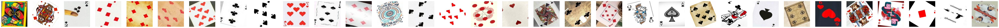

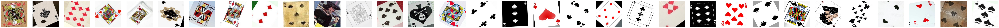

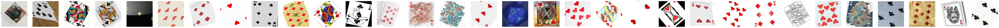

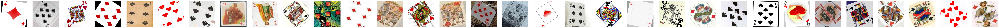

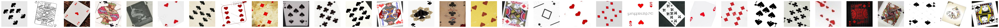

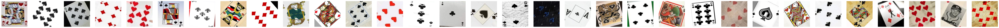

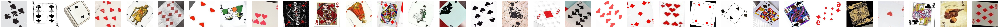

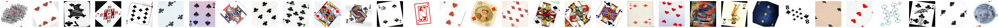

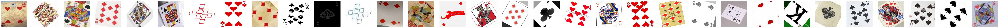

In [5]:
# Plot augmented images from a sample of 10 batches
for batch_index in range(1,10):
    image_batch, label_batch = next(train_generator)
    num_images_in_batch = image_batch.shape[0]

    plt.figure(figsize=(100, 8))
    for i in range(num_images_in_batch):
        plt.subplot(1, num_images_in_batch, i + 1)
        plt.imshow(image_batch[i].astype('uint8'))
        plt.axis('off')
    plt.show()

## Load, Preprocess, and Extract

In [6]:
# Load and preprocess the images
def load_and_preprocess_image(filepath):
    image = cv2.imread(filepath)
    image = cv2.resize(image, (224, 224))
    return image

# Convert image to grayscale
def convert_to_grayscale(images):
    gray_images = np.array([cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) for img in images])
    return gray_images

# Extract HOG feature vectors
def extract_hog_features(images):
    hog_features = []
    for img in images:
        hog_feature = hog(img, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2))
        hog_features.append(hog_feature)
    return np.array(hog_features)

# Extract HOG features with hue
def extract_hog_features_with_hue(images):
    hog_features = []
    for img in images:
        hsv_img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        hue_channel = hsv_img[:, :, 0]  # Extract the Hue channel
        hog_feature = hog(hue_channel, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2))
        hog_features.append(hog_feature)
    return np.array(hog_features)

## Extract Features

In [7]:
# Load data from the generators
train_images = np.array([load_and_preprocess_image(train_generator.filepaths[i]) for i in range(len(train_generator.filenames))])
valid_images = np.array([load_and_preprocess_image(valid_generator.filepaths[j]) for j in range(len(valid_generator.filenames))])
test_images = np.array([load_and_preprocess_image(test_generator.filepaths[k]) for k in range(len(test_generator.filenames))])

# Convert to grayscale
train_gray_images = convert_to_grayscale(train_images)
valid_gray_images = convert_to_grayscale(valid_images)
test_gray_images = convert_to_grayscale(test_images)

# Extract HOG feature vectors from the grayscale images
train_hog_features_gray = extract_hog_features(train_gray_images)
valid_hog_features_gray = extract_hog_features(valid_gray_images)
test_hog_features_gray = extract_hog_features(test_gray_images)

# Extract HOG feature vectors from the Hue channel
train_hog_features_hue = extract_hog_features_with_hue(train_images)
valid_hog_features_hue = extract_hog_features_with_hue(valid_images)
test_hog_features_hue = extract_hog_features_with_hue(test_images)

# Concatenate the HOG features from grayscale and Hue channels
train_hog_features_combined = np.concatenate((train_hog_features_gray, train_hog_features_hue), axis=1)
valid_hog_features_combined = np.concatenate((valid_hog_features_gray, valid_hog_features_hue), axis=1)
test_hog_features_combined = np.concatenate((test_hog_features_gray, test_hog_features_hue), axis=1)

In [8]:
# Use LabelEncoder to convert string labels to integer values
label_encoder = LabelEncoder()
train_labels = label_encoder.fit_transform(train_df['suit'])
valid_labels = label_encoder.transform(val_df['suit'])
test_labels = label_encoder.transform(test_df['suit'])

# Convert labels to arrays and one-hot encode 
train_labels = to_categorical(train_labels, num_classes=4)
valid_labels = to_categorical(valid_labels, num_classes=4)
test_labels = to_categorical(test_labels, num_classes=4)

## Random Forest Model with Hyperparameter Search

In [9]:
# Define the parameter distributions for Random Search
param_dist = {
    'n_estimators': randint(1, 20),  # Number of trees in the forest
    'max_depth': [None] + list(range(10, 30, 10)),  # Maximum depth of the tree
    'min_samples_split': randint(2, 5),  # Minimum number of samples required to split an internal node
    'min_samples_leaf': randint(1, 5)  # Minimum number of samples required to be at a leaf node
}

# Initialize the Random Forest classifier
rf_classifier = RandomForestClassifier(random_state=42)

# Create a RandomizedSearchCV object
random_search = RandomizedSearchCV(rf_classifier, param_distributions=param_dist, n_iter=10, cv=3, n_jobs=-1)

# Train the Random Search on train_hog_features and train_labels
random_search.fit(train_hog_features_combined, train_generator.labels)

# Print the best hyperparameters found by Random Search
print("Best hyperparameters:", random_search.best_params_)

Best hyperparameters: {'max_depth': 10, 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 16}


In [10]:
# Retrieve the best Random Forest classifier
best_rf_classifier = random_search.best_estimator_

In [11]:
# Evaluate the best Random Forest classifier on the validation set
# valid_hog_features = extract_hog_features(valid_gray_images)
valid_accuracy = best_rf_classifier.score(valid_hog_features_combined, valid_generator.labels)
print("Validation Accuracy:", valid_accuracy)

Validation Accuracy: 0.6038910505836576


In [12]:
# Evaluate the best Random Forest classifier on the test set
# test_hog_features = extract_hog_features(test_gray_images)
test_accuracy = best_rf_classifier.score(test_hog_features_combined, test_generator.labels)
print("Test Accuracy:", test_accuracy)

Test Accuracy: 0.6033623910336239


## Classification Report

In [13]:
# Predict labels for the test set using the best SVM classifier
test_predictions = best_rf_classifier.predict(test_hog_features_combined)

In [14]:
# Print the classification report
print("Classification Report:")
print(classification_report(test_generator.labels, test_predictions))

Classification Report:
              precision    recall  f1-score   support

           0       0.60      0.57      0.58       387
           1       0.61      0.64      0.62       392
           2       0.62      0.62      0.62       395
           3       0.58      0.59      0.59       432

    accuracy                           0.60      1606
   macro avg       0.60      0.60      0.60      1606
weighted avg       0.60      0.60      0.60      1606



## Confusion Matrix

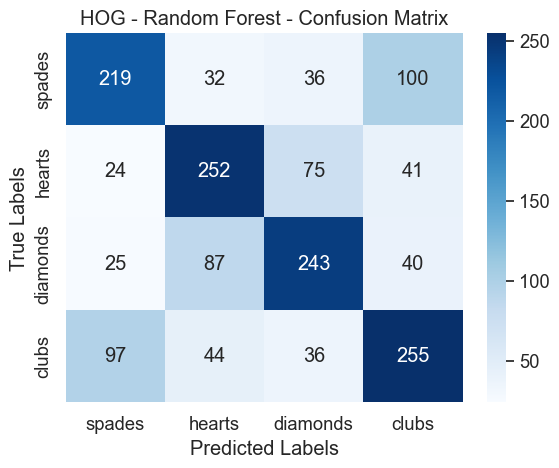

In [15]:
conf_matrix = confusion_matrix(test_generator.labels, test_predictions)

# Define the class labels
class_labels = ['spades', 'hearts', 'diamonds', 'clubs']

# Create the seaborn heatmap
sns.set(font_scale=1.2)
sns.heatmap(conf_matrix, 
            annot=True, 
            fmt="d", 
            cmap="Blues", 
            xticklabels=class_labels, 
            yticklabels=class_labels)

# Add labels and title
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("HOG - Random Forest - Confusion Matrix")

# Show the plot
plt.show()

## CNN Model with Hyperparameter Search

In [16]:
def nn_model(hp):
    model = Sequential()
    model.add(Dense(units = hp.Int('units_1', min_value = 16, max_value = 128, step = 16), activation='relu', input_shape = (train_hog_features_combined.shape[1],)))
    model.add(Dropout(0.2))
    model.add(Dense(units = hp.Int('units_2', min_value = 16, max_value = 128, step=16), activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(units = hp.Int('units_3', min_value = 16, max_value = 128, step=16), activation='relu'))
    model.add(Dense(num_classes, activation='softmax'))

    model.compile(optimizer=Adam(learning_rate=hp.Choice('learning_rate', values=[1e-4, 1e-5, 1e-6])), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

In [17]:
def hyperparameter_search(train_data, train_labels, valid_data, valid_labels):
    tuner = kt.RandomSearch(
        nn_model,
        objective='val_accuracy',
        max_trials=50,  # Number of hyperparameter combinations to try
        directory='hyperparameter_search',
        project_name='hog_classifier',
        overwrite=True,
    )

    # Perform the hyperparameter search
    tuner.search(train_data, train_labels, epochs=10, validation_data=(valid_data, valid_labels))

    # Get the best hyperparameters
    best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

    return best_hps

In [18]:
num_classes = 4

# Perform hyperparameter search
best_hyperparameters = hyperparameter_search(train_hog_features_combined, train_labels, valid_hog_features_combined, valid_labels)
print("Best hyperparameters:")
print(best_hyperparameters)

Trial 50 Complete [00h 00m 48s]
val_accuracy: 0.3797665238380432

Best val_accuracy So Far: 0.7844358086585999
Total elapsed time: 00h 38m 38s
INFO:tensorflow:Oracle triggered exit


INFO:tensorflow:Oracle triggered exit


Best hyperparameters:


In [20]:
# Train the model with the best hyperparameters
callback = tf.keras.callbacks.EarlyStopping(monitor = 'loss', patience = 3)

final_nn_model = nn_model(best_hyperparameters)
history = final_nn_model.fit(train_hog_features_combined, 
                              train_labels, epochs = 15, 
                              batch_size = 32, 
                              callbacks = [callback],
                              validation_data = (valid_hog_features_combined, valid_labels))


Epoch 1/15


2023-08-08 22:19:54.975220: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


161/161 [==============================] - ETA: 0s - loss: 1.5221 - accuracy: 0.3383

2023-08-08 22:20:00.226735: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


161/161 [==============================] - 6s 34ms/step - loss: 1.5221 - accuracy: 0.3383 - val_loss: 1.1080 - val_accuracy: 0.4895
Epoch 2/15
161/161 [==============================] - 3s 21ms/step - loss: 1.2100 - accuracy: 0.4416 - val_loss: 0.9677 - val_accuracy: 0.5907
Epoch 3/15
161/161 [==============================] - 3s 20ms/step - loss: 1.0391 - accuracy: 0.5064 - val_loss: 0.9378 - val_accuracy: 0.5409
Epoch 4/15
161/161 [==============================] - 3s 21ms/step - loss: 0.9235 - accuracy: 0.5708 - val_loss: 0.8477 - val_accuracy: 0.6537
Epoch 5/15
161/161 [==============================] - 3s 21ms/step - loss: 0.7982 - accuracy: 0.6460 - val_loss: 0.7468 - val_accuracy: 0.6934
Epoch 6/15
161/161 [==============================] - 3s 21ms/step - loss: 0.6756 - accuracy: 0.7228 - val_loss: 0.6920 - val_accuracy: 0.7074
Epoch 7/15
161/161 [==============================] - 3s 20ms/step - loss: 0.5332 - accuracy: 0.7953 - val_loss: 0.7151 - val_accuracy: 0.7074
Epoch 8/15

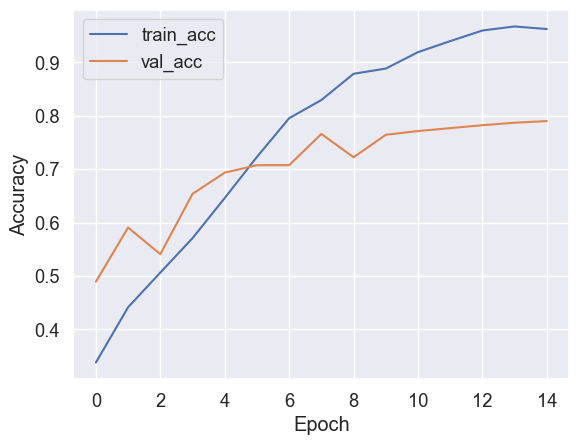

In [21]:
# Plot accuracy
plt.plot(history.history['accuracy'], label='train_acc')
plt.plot(history.history['val_accuracy'], label='val_acc')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

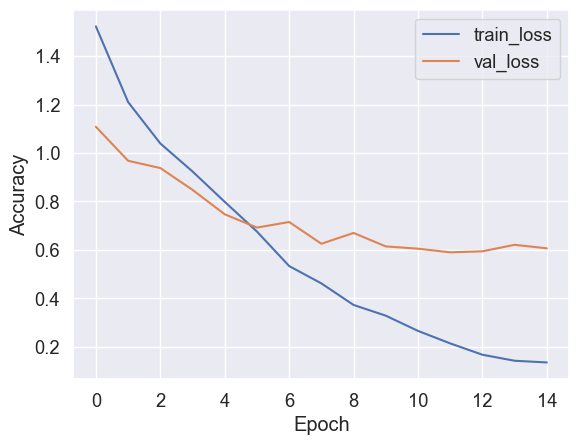

In [22]:
#Plot Loss
plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [25]:
# Make predictions on the validation set
valid_predictions_probs = final_nn_model.predict(valid_hog_features_combined)
valid_predictions = np.argmax(valid_predictions_probs, axis=1)
valid_accuracy = accuracy_score(valid_generator.labels, valid_predictions) # Calculate validation accuracy
print("Validation Accuracy:", valid_accuracy)

# Make predictions on the test set
test_predictions_probs = final_nn_model.predict(test_hog_features_combined)
test_predictions = np.argmax(test_predictions_probs, axis=1)
test_accuracy = accuracy_score(test_generator.labels, test_predictions) # Calculate test accuracy
print("Test Accuracy:", test_accuracy)

29/41 [====================>.........] - ETA: 0s

2023-08-08 22:21:07.774852: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


41/41 [==============================] - 1s 6ms/step
Validation Accuracy: 0.7898832684824902
51/51 [==============================] - 0s 8ms/step
Test Accuracy: 0.7995018679950187


## Classification Report

In [26]:
# Get the class names from the generator (assuming it has the 'class_indices' attribute)
class_names = list(test_generator.class_indices.keys())

# Calculate classification report for validation set
valid_report = classification_report(valid_generator.labels, valid_predictions, target_names=class_names)
print("Validation Classification Report:\n", valid_report)

# Calculate classification report for test set
test_report = classification_report(test_generator.labels, test_predictions, target_names=class_names)
print("Test Classification Report:\n", test_report)

Validation Classification Report:
               precision    recall  f1-score   support

       clubs       0.77      0.77      0.77       310
    diamonds       0.83      0.81      0.82       313
      hearts       0.80      0.82      0.81       316
      spades       0.77      0.77      0.77       346

    accuracy                           0.79      1285
   macro avg       0.79      0.79      0.79      1285
weighted avg       0.79      0.79      0.79      1285

Test Classification Report:
               precision    recall  f1-score   support

       clubs       0.81      0.76      0.79       387
    diamonds       0.84      0.79      0.82       392
      hearts       0.80      0.84      0.82       395
      spades       0.76      0.80      0.78       432

    accuracy                           0.80      1606
   macro avg       0.80      0.80      0.80      1606
weighted avg       0.80      0.80      0.80      1606



## Confusion Matrix

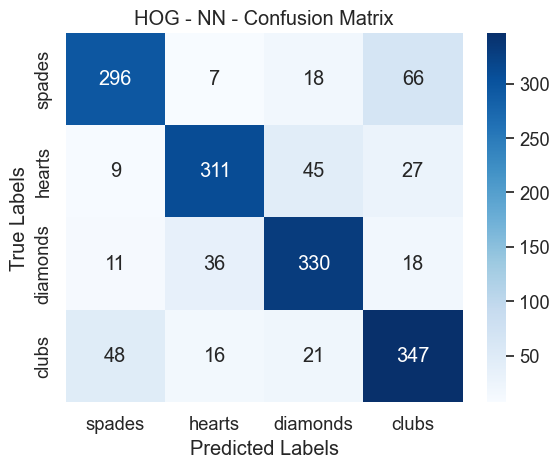

In [27]:
conf_matrix = confusion_matrix(test_generator.labels, test_predictions)

# Define the class labels
class_labels = ['spades', 'hearts', 'diamonds', 'clubs']

# Create the seaborn heatmap
sns.set(font_scale=1.2)
sns.heatmap(conf_matrix, 
            annot=True, 
            fmt="d", 
            cmap="Blues", 
            xticklabels=class_labels, 
            yticklabels=class_labels)

# Add labels and title
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("HOG - NN - Confusion Matrix")

# Show the plot
plt.show()